Top 5 performers based on weekly returns

In [8]:
import pandas as pd
ohlc_data = pd.read_csv('/content/ticker_data.csv')
def get_top_performers(ohlc_data):
    ohlc_data['Date'] = pd.to_datetime(ohlc_data['Date'],  errors ='coerce')
    ohlc_data.set_index('Date', inplace=True)
    weekly_returns = ohlc_data.groupby('Ticker')['Close'].resample('W').last().pct_change().dropna()
    top_performers = weekly_returns.groupby('Ticker').mean().nlargest(5)
    return top_performers
top_performers = get_top_performers(ohlc_data)
print(top_performers)

Ticker
BATAINDIA.NS     0.154428
ASIANPAINT.NS    0.030282
ABB.NS           0.029759
APOLLOTYRE.NS    0.020658
ABBOTINDIA.NS    0.020127
Name: Close, dtype: float64


Weekly top 5 performers with Stop loss as 2 times ATR on the entry price.

In [9]:
ohlc_data['High-Low'] = ohlc_data['High'] - ohlc_data['Low']
ohlc_data['High-PrevClose'] = abs(ohlc_data['High'] - ohlc_data['Close'].shift(1))
ohlc_data['Low-PrevClose'] = abs(ohlc_data['Low'] - ohlc_data['Close'].shift(1))
ohlc_data['TR'] = ohlc_data[['High-Low', 'High-PrevClose', 'Low-PrevClose']].max(axis=1)
ohlc_data['ATR'] = ohlc_data['TR'].rolling(window=14).mean()

filtered_data = ohlc_data[ohlc_data['Ticker'].isin(top_performers.index)]

trades = []
for ticker, data in filtered_data.groupby('Ticker'):
    entry_price = data['Close'].iloc[0]
    atr = data['ATR'].iloc[-1]
    stop_loss = entry_price - (2 * atr)
    trades.append({'Ticker': ticker, 'EntryPrice': entry_price, 'StopLoss': stop_loss})

trades_df = pd.DataFrame(trades)

print(trades_df)

          Ticker    EntryPrice      StopLoss
0         ABB.NS    922.349976    736.392596
1  ABBOTINDIA.NS  15727.000000  14977.250836
2  APOLLOTYRE.NS    108.449997     90.064290
3  ASIANPAINT.NS   1691.949951   1593.257080
4   BATAINDIA.NS   1312.400024   1217.357177


Weekly performance of all the 5 stocks with stop loss as 2 times ATR on the entry price

In [10]:
ohlc_data['High-Low'] = ohlc_data['High'] - ohlc_data['Low']
ohlc_data['High-PrevClose'] = abs(ohlc_data['High'] - ohlc_data['Close'].shift(1))
ohlc_data['Low-PrevClose'] = abs(ohlc_data['Low'] - ohlc_data['Close'].shift(1))
ohlc_data['TR'] = ohlc_data[['High-Low', 'High-PrevClose', 'Low-PrevClose']].max(axis=1)
ohlc_data['ATR'] = ohlc_data['TR'].rolling(window=14).mean()
trades_df = pd.DataFrame(columns=['Ticker', 'EntryPrice', 'StopLoss'])
for week, weekly_data in ohlc_data.groupby(pd.Grouper(freq='W')):
    filtered_data = weekly_data[weekly_data['Ticker'].isin(top_performers.index)]
    trades = []
    for ticker, data in filtered_data.groupby('Ticker'):
        entry_price = data['Close'].iloc[0]
        atr = data['ATR'].iloc[-1]
        stop_loss = entry_price - (2 * atr)
        trades.append({'Ticker': ticker, 'EntryPrice': entry_price, 'StopLoss': stop_loss})
    trades_df = pd.concat([trades_df, pd.DataFrame(trades)], ignore_index=True)

print(trades_df)

            Ticker    EntryPrice      StopLoss
0           ABB.NS    954.299988    836.821411
1    ABBOTINDIA.NS  15755.950200  15311.778744
2    APOLLOTYRE.NS    109.750000     97.957145
3    ASIANPAINT.NS   1688.000000   1590.000035
4     BATAINDIA.NS   1285.000000   1198.749991
..             ...           ...           ...
692  ASIANPAINT.NS   2915.949951   2815.450021
693         ABB.NS   3203.550049   3003.628523
694  ABBOTINDIA.NS  22643.300780  21996.036550
695  APOLLOTYRE.NS    324.049988    310.414276
696  ASIANPAINT.NS   2786.750000   2697.042899

[697 rows x 3 columns]


Rebalancing the stocks on weekly basis

In [11]:
def calculate_commission(trade_value, commission_rate):
    commission = trade_value * commission_rate
    return commission

def calculate_slippage(entry_price, exit_price, slippage_percent):
    slippage = (entry_price + exit_price) * slippage_percent
    return slippage
ohlcv_data = pd.read_csv('/content/ticker_data.csv')

entry_date = '20-06-22'
exit_date = '23-06-21'
trade_quantity = 100
commission_rate = 0.01
slippage_percent = 0.005

entry_row = ohlcv_data[ohlcv_data['Date'] == entry_date].iloc[0]
exit_row = ohlcv_data[ohlcv_data['Date'] == exit_date].iloc[0]
entry_price = entry_row['Close']
exit_price = exit_row['Close']
trade_value = (entry_price + exit_price) * trade_quantity
commission = calculate_commission(trade_value, commission_rate)
slippage = calculate_slippage(entry_price, exit_price, slippage_percent)
print("Trade Value:", trade_value)
print("Commission:", commission)
print("Slippage:", slippage)

Trade Value: 20690.000157
Commission: 206.90000157
Slippage: 1.03450000785


Ticker: ABCAPITAL.NS
Volatility: 0.41632832344089127
Max Drawdown: nan
Sharpe Ratio: -0.11643152918339719
            Date        Ticker   Returns  CumulativeReturns
0       29-06-20  ABCAPITAL.NS       NaN                NaN
1       30-06-20  ABCAPITAL.NS -0.037262           0.962738
2       01-07-20  ABCAPITAL.NS  0.015798           0.977947
3       02-07-20  ABCAPITAL.NS  0.048989           1.025855
4       03-07-20  ABCAPITAL.NS -0.027428           0.997719
...          ...           ...       ...                ...
743     22-06-23  ABCAPITAL.NS -0.046918           2.610646
744     23-06-23  ABCAPITAL.NS  0.019516           2.661597
745     26-06-23  ABCAPITAL.NS  0.035714           2.756654
138911  29-11-22  ABCAPITAL.NS -0.204965           2.191635
138912  05-12-22  ABCAPITAL.NS  0.100971           2.412928

[748 rows x 4 columns]
Ticker: ABB.NS
Volatility: 0.4747033982693258
Max Drawdown: nan
Sharpe Ratio: -0.1017514797865015
            Date  Ticker   Returns  CumulativeReturn

<ipython-input-25-ed648c483ee2>:35: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(10, 6))


Ticker: GODREJCP.NS
Volatility: 0.3133559738070154
Max Drawdown: nan
Sharpe Ratio: -0.15789597479772213
            Date       Ticker   Returns  CumulativeReturns
8206    29-06-20  GODREJCP.NS       NaN                NaN
8207    30-06-20  GODREJCP.NS  0.004581           1.004581
8208    01-07-20  GODREJCP.NS  0.005863           1.010470
8209    02-07-20  GODREJCP.NS  0.002950           1.013452
8210    03-07-20  GODREJCP.NS  0.029272           1.043118
...          ...          ...       ...                ...
8950    23-06-23  GODREJCP.NS -0.004756           1.506508
8951    26-06-23  GODREJCP.NS -0.003523           1.501200
138933  12-05-21  GODREJCP.NS -0.154461           1.269323
138934  24-12-21  GODREJCP.NS  0.107006           1.405148
138935  06-07-22  GODREJCP.NS -0.089314           1.279648

[749 rows x 4 columns]
Ticker: HINDPETRO.NS
Volatility: 0.3306437676287817
Max Drawdown: nan
Sharpe Ratio: -0.15022991873046201
            Date        Ticker   Returns  CumulativeReturns

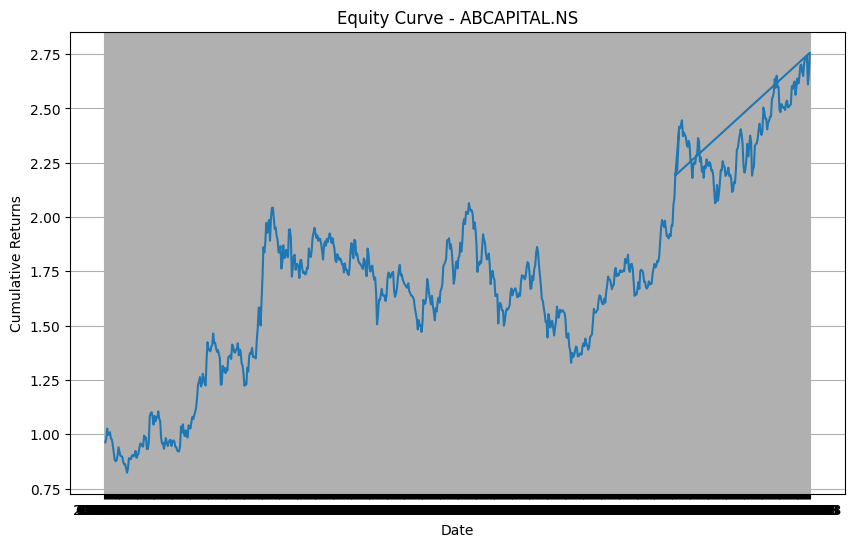

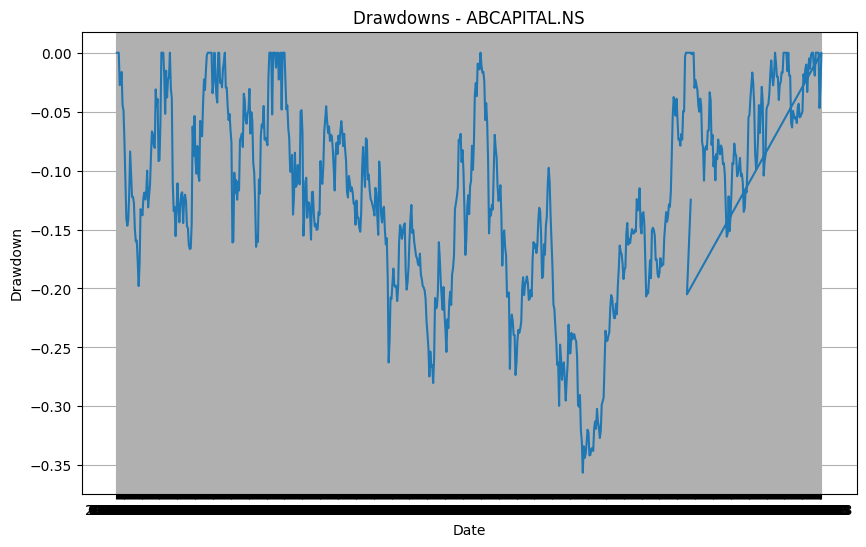

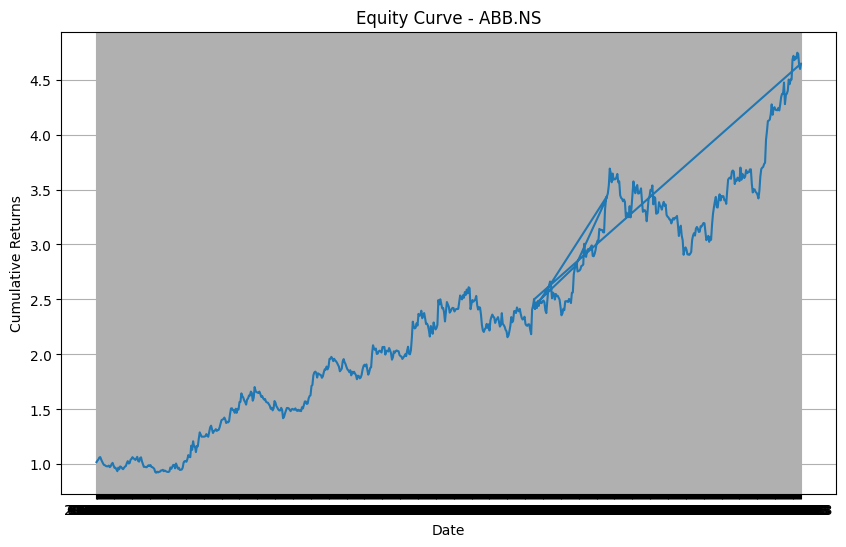

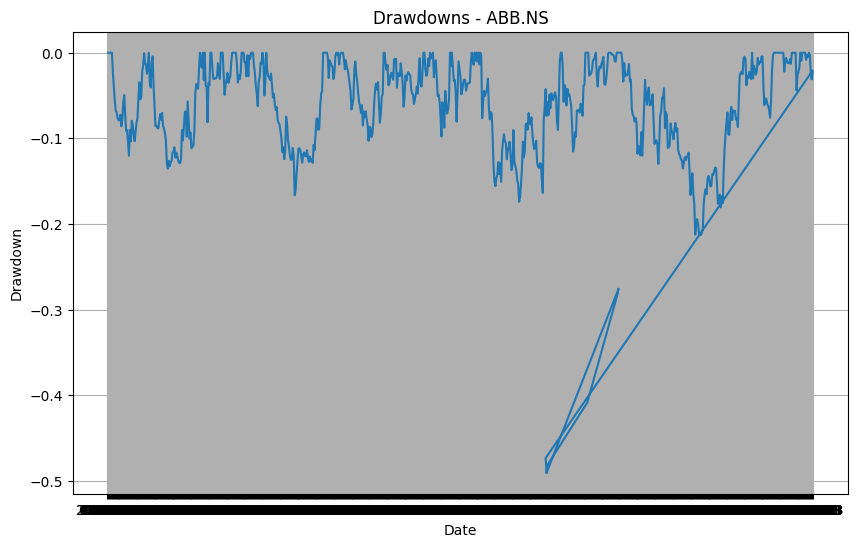

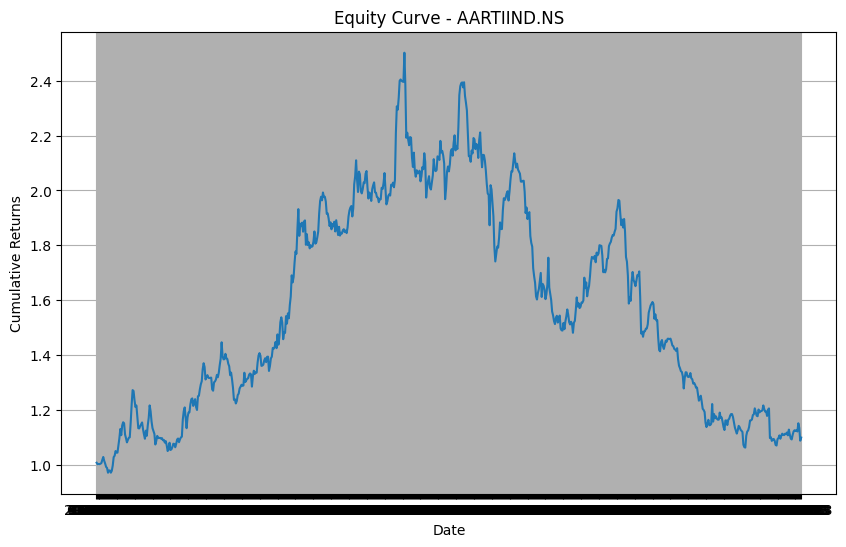

...

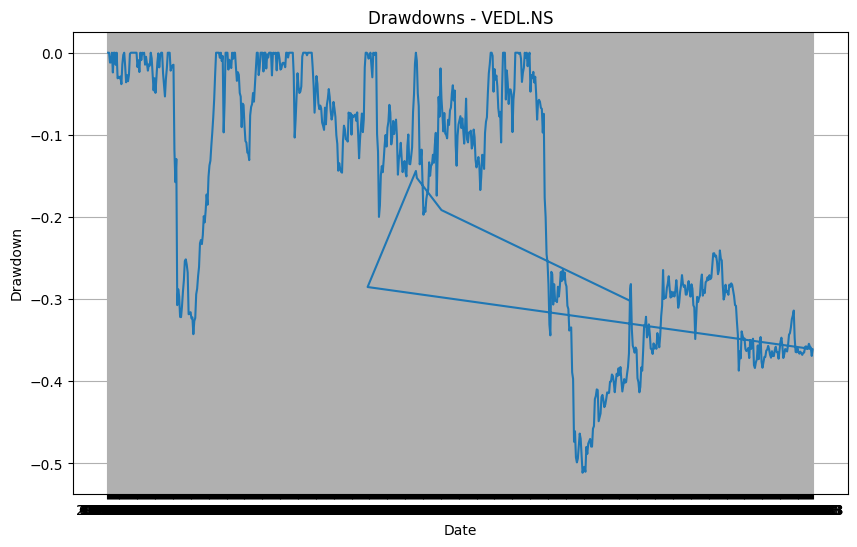

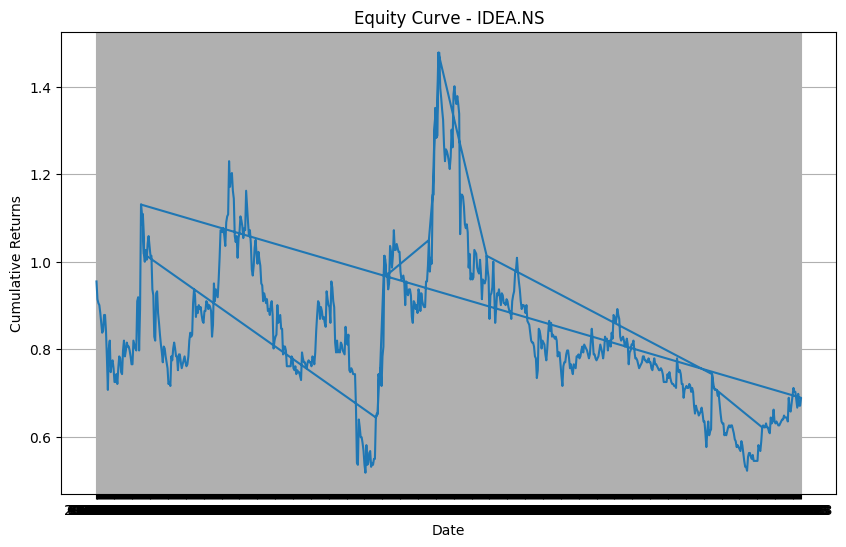

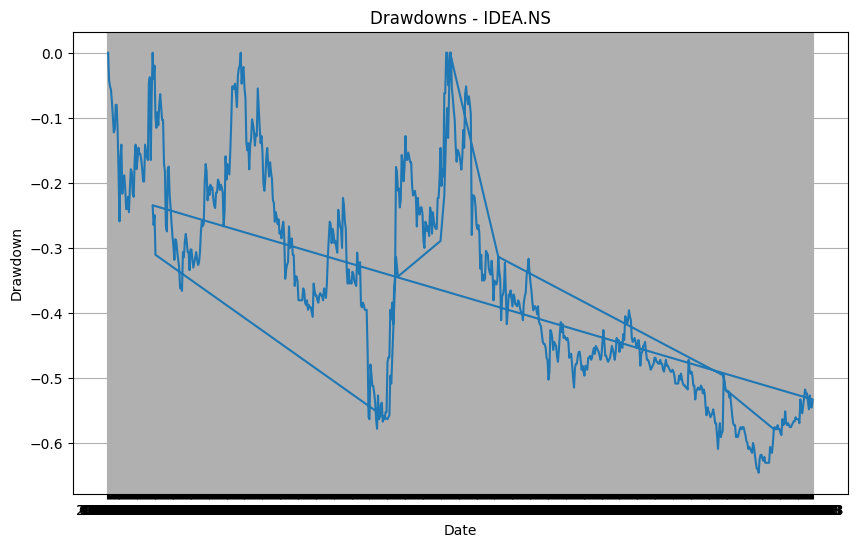

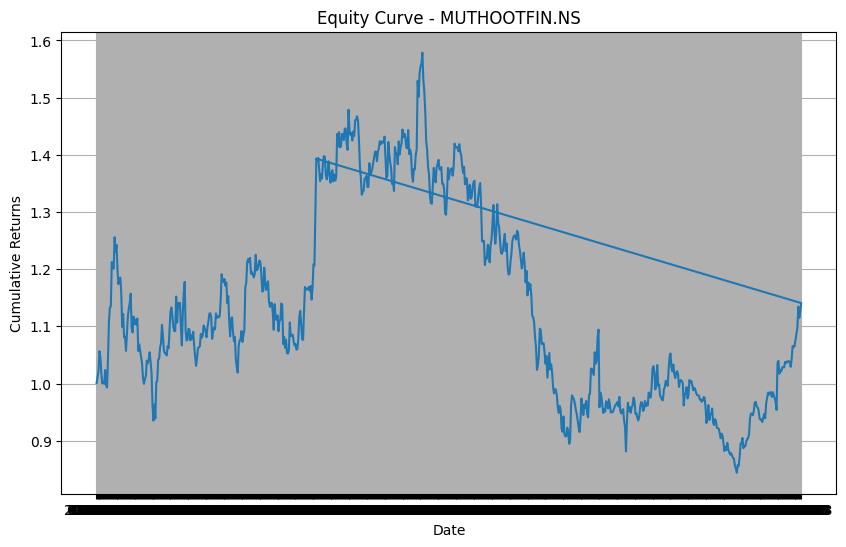

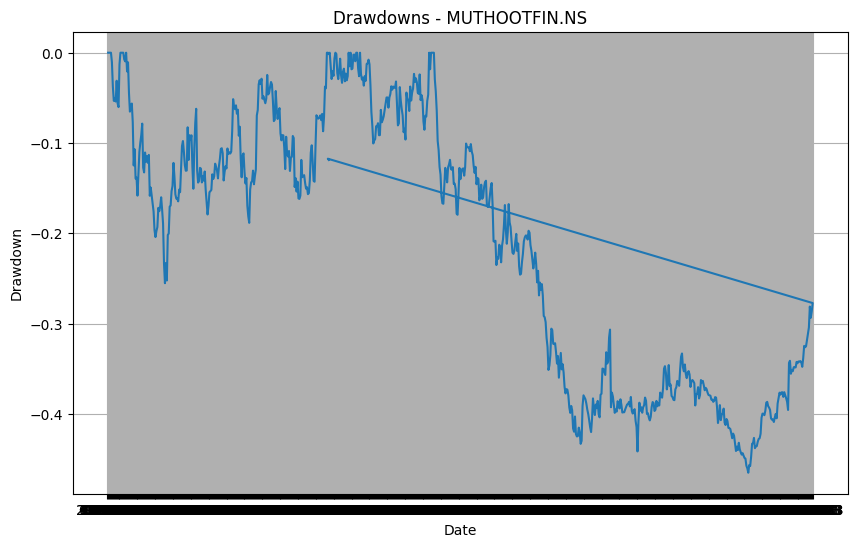

In [25]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

backtest_results = pd.read_csv('/content/ticker_data.csv')

combined_data = pd.DataFrame()  # DataFrame to store combined data for all tickers

# Iterate over unique tickers
tickers = backtest_results['Ticker'].unique()
for ticker in tickers:
    ticker_data = backtest_results[backtest_results['Ticker'] == ticker].copy()

    ticker_data['Returns'] = ticker_data['Close'].pct_change()
    volatility = np.std(ticker_data['Returns']) * np.sqrt(252)

    ticker_data['CumulativeReturns'] = (1 + ticker_data['Returns']).cumprod()
    ticker_data['Peak'] = ticker_data['CumulativeReturns'].cummax()
    ticker_data['Drawdown'] = (ticker_data['CumulativeReturns'] / ticker_data['Peak']) - 1

    max_drawdown = min(ticker_data['Drawdown'])
    risk_free_rate = 0.05
    sharpe_ratio = (np.mean(ticker_data['Returns']) - risk_free_rate) / volatility

    print("Ticker:", ticker)
    print("Volatility:", volatility)
    print("Max Drawdown:", max_drawdown)
    print("Sharpe Ratio:", sharpe_ratio)
    print(ticker_data[['Date', 'Ticker', 'Returns', 'CumulativeReturns']])

    # Append the ticker data to the combined_data DataFrame
    combined_data = pd.concat([combined_data, ticker_data[['Date', 'Ticker', 'Returns', 'CumulativeReturns']]], axis=0)

    # Generate equity curve plot
    plt.figure(figsize=(10, 6))
    plt.plot(ticker_data['Date'], ticker_data['CumulativeReturns'])
    plt.title(f'Equity Curve - {ticker}')
    plt.xlabel('Date')
    plt.ylabel('Cumulative Returns')
    plt.grid(True)
    # plt.show()

    # Generate drawdowns plot
    plt.figure(figsize=(10, 6))
    plt.plot(ticker_data['Date'], ticker_data['Drawdown'])
    plt.title(f'Drawdowns - {ticker}')
    plt.xlabel('Date')
    plt.ylabel('Drawdown')
    plt.grid(True)
    # plt.show()

# Save the combined data for all tickers to a CSV file
combined_data_file = '/content/CombinedData.csv'
combined_data.to_csv(combined_data_file, index=False)

Performing backtest on 3 years data with complete analysis of the strategy using pyfolio.

In [26]:
pip install git+https://github.com/quantopian/pyfolio

  Cloning https://github.com/quantopian/pyfolio to /tmp/pip-req-build-3udir7ap
  Running command git clone --filter=blob:none --quiet https://github.com/quantopian/pyfolio /tmp/pip-req-build-3udir7ap
  Resolved https://github.com/quantopian/pyfolio to commit 4b901f6d73aa02ceb6d04b7d83502e5c6f2e81aa
  Preparing metadata (setup.py) ... done


/usr/local/lib/python3.10/dist-packages/pyfolio/timeseries.py:724: FutureWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  stats = pd.Series()
/usr/local/lib/python3.10/dist-packages/pyfolio/plotting.py:648: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for stat, value in perf_stats[column].iteritems():


Start date,1970-01-01
End date,1970-01-01
Total months,6652
,Backtest
Annual return,0.115%
Cumulative returns,89.278%
Annual volatility,1306.576%
Sharpe ratio,0.19
Calmar ratio,0.00
Stability,0.01
Max drawdown,-99.994%


/usr/local/lib/python3.10/dist-packages/pyfolio/timeseries.py:1008: UserWarning: Discarding nonzero nanoseconds in conversion.
  df_drawdowns.loc[i, 'Peak date'] = (peak.to_pydatetime()
/usr/local/lib/python3.10/dist-packages/pyfolio/timeseries.py:1010: UserWarning: Discarding nonzero nanoseconds in conversion.
  df_drawdowns.loc[i, 'Valley date'] = (valley.to_pydatetime()
/usr/local/lib/python3.10/dist-packages/pyfolio/timeseries.py:1015: UserWarning: Discarding nonzero nanoseconds in conversion.
  df_drawdowns.loc[i, 'Recovery date'] = (recovery.to_pydatetime()


Worst drawdown periods,Net drawdown in %,Peak date,Valley date,Recovery date,Duration
0,99.99,1970-01-01,1970-01-01,NaT,NaN
1,99.92,1970-01-01,1970-01-01,1970-01-01,1
2,97.43,1970-01-01,1970-01-01,1970-01-01,1
3,35.63,1970-01-01,1970-01-01,1970-01-01,1
4,34.06,1970-01-01,1970-01-01,1970-01-01,1


/usr/local/lib/python3.10/dist-packages/pyfolio/plotting.py:805: FutureWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  oos_cum_returns = pd.Series([])
/usr/local/lib/python3.10/dist-packages/pyfolio/plotting.py:805: FutureWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  oos_cum_returns = pd.Series([])
/usr/local/lib/python3.10/dist-packages/pyfolio/plotting.py:805: FutureWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  oos_cum_returns = pd.Series([])
/usr/local/lib/python3.10/dist-packages/pyfolio/timeseries.py:1008: UserWarning: Discarding nonzero nanoseconds in conversion.
  df_drawdowns.loc[i, 'Peak date'] = (peak.to_pydatetime()
/usr/local/lib/python3.10/dist-pac

Start date,1970-01-01
End date,1970-01-01
Total months,6652
,Backtest
Annual return,0.115%
Cumulative returns,89.278%
Annual volatility,1306.576%
Sharpe ratio,0.19
Calmar ratio,0.00
Stability,0.01
Max drawdown,-99.994%


/usr/local/lib/python3.10/dist-packages/pyfolio/timeseries.py:1008: UserWarning: Discarding nonzero nanoseconds in conversion.
  df_drawdowns.loc[i, 'Peak date'] = (peak.to_pydatetime()
/usr/local/lib/python3.10/dist-packages/pyfolio/timeseries.py:1010: UserWarning: Discarding nonzero nanoseconds in conversion.
  df_drawdowns.loc[i, 'Valley date'] = (valley.to_pydatetime()
/usr/local/lib/python3.10/dist-packages/pyfolio/timeseries.py:1015: UserWarning: Discarding nonzero nanoseconds in conversion.
  df_drawdowns.loc[i, 'Recovery date'] = (recovery.to_pydatetime()


Worst drawdown periods,Net drawdown in %,Peak date,Valley date,Recovery date,Duration
0,99.99,1970-01-01,1970-01-01,NaT,NaN
1,99.92,1970-01-01,1970-01-01,1970-01-01,1
2,97.43,1970-01-01,1970-01-01,1970-01-01,1
3,35.63,1970-01-01,1970-01-01,1970-01-01,1
4,34.06,1970-01-01,1970-01-01,1970-01-01,1


/usr/local/lib/python3.10/dist-packages/pyfolio/plotting.py:805: FutureWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  oos_cum_returns = pd.Series([])
/usr/local/lib/python3.10/dist-packages/pyfolio/plotting.py:805: FutureWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  oos_cum_returns = pd.Series([])
/usr/local/lib/python3.10/dist-packages/pyfolio/plotting.py:805: FutureWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  oos_cum_returns = pd.Series([])
/usr/local/lib/python3.10/dist-packages/pyfolio/timeseries.py:1008: UserWarning: Discarding nonzero nanoseconds in conversion.
  df_drawdowns.loc[i, 'Peak date'] = (peak.to_pydatetime()
/usr/local/lib/python3.10/dist-pac

No overlapping data between returns and benchmark_returns.


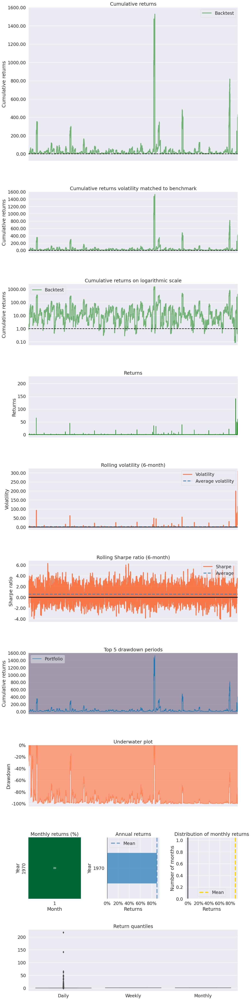

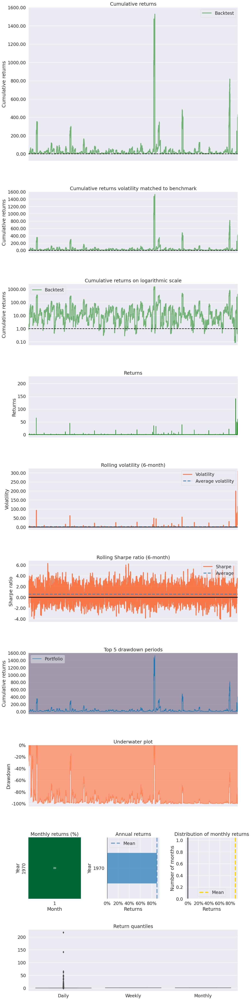

In [38]:
import pandas as pd
import pyfolio as pf
import matplotlib.pyplot as plt

# Read backtested results from a CSV file
backtest_results = pd.read_csv('/content/ticker_data.csv')

# Convert the date column to datetime
backtest_results['Date'] = pd.to_datetime(backtest_results['Date'], format='%d-%m-%y')

# Set the date column as the DataFrame index
backtest_results.set_index('Date', inplace=True)

# Calculate daily returns
backtest_results['Returns'] = backtest_results['Close'].pct_change()

# Convert returns to a Pyfolio compatible format
returns = backtest_results['Returns'].dropna()

# Reset the index of the returns DataFrame
returns.reset_index(drop=True, inplace=True)

# Convert the index to datetime
returns.index = pd.to_datetime(returns.index)

# Check for invalid values in returns and convert them to NaN
returns = pd.to_numeric(returns, errors='coerce')

# Calculate various performance metrics
pf.create_returns_tear_sheet(returns)

# Analyze risk and drawdowns
pf.create_full_tear_sheet(returns)

# Benchmarking against a benchmark index
benchmark_returns = pd.read_csv('/content/CombinedData.csv')

# Convert the date column to datetime
benchmark_returns['Date'] = pd.to_datetime(benchmark_returns['Date'], format='%d-%m-%y')

# Set the date column as the DataFrame index
benchmark_returns.set_index('Date', inplace=True)

# Convert benchmark_returns to a Series
benchmark_returns = benchmark_returns['CumulativeReturns']

# Check for invalid values in benchmark_returns and convert them to NaN
benchmark_returns = pd.to_numeric(benchmark_returns, errors='coerce')

# Align the indexes of returns and benchmark_returns
aligned_returns, aligned_benchmark_returns = returns.align(benchmark_returns, join='inner')

# Check if there are overlapping index values
if len(aligned_returns) > 0 and len(aligned_benchmark_returns) > 0:
    # Calculate various performance metrics with benchmark
    pf.create_returns_tear_sheet(aligned_returns, benchmark_rets=aligned_benchmark_returns)

    # Generate performance plots
    with pd.option_context('mode.use_inf_as_na', True):  # Treat infinity as NaN
        pf.plotting.plot_rolling_beta(aligned_returns, aligned_benchmark_returns)
        pf.plotting.plot_rolling_sharpe(aligned_returns)
        pf.plotting.plot_rolling_volatility(aligned_returns)

    # Display the plots
    plt.show()
else:
    print("No overlapping data between returns and benchmark_returns.")